In [1]:
# We import the usual libraries
import numpy as np
import matplotlib.pyplot as plt
import cv2
import os  # to load the images from a folder
from sklearn.decomposition import PCA

In [43]:
# We import the functions that implement k-means, DBSCAN and Gaussian Mixture
from sklearn.cluster import KMeans, DBSCAN
from sklearn.mixture import GaussianMixture

In [3]:
# We import the data
data = []
# print(os.getcwd())
os.chdir("/home/maribel/ml-project-2-ml-plume-1/Automatic_Filtering")
folderSave = 'Save_3K'
filenames = os.listdir(folderSave)
for filename in filenames:
        img = cv2.imread(os.path.join(folderSave,filename), cv2.IMREAD_GRAYSCALE)
        data.append(img)
data = np.array(data)

In [4]:
print(data.shape)
transformed_data = data.reshape((data.shape[0], data.shape[1]*data.shape[2]))

pca = PCA(n_components = 100)
pca.fit(transformed_data)
trans_pca = pca.transform(transformed_data)
img_reduced = pca.inverse_transform(trans_pca)

(1000, 128, 160)


In [5]:
np.random.seed(1)

In [6]:
# We have 3 different clusters:
#  * Triangle with overflow
#  * Triangle without overflow
#  * Patatoid with overflow
#  * Bad Images
n = 4

In [7]:
# We classify the data with k-means
kmeans = KMeans(n_clusters=n,init='random')
kmeans.fit(img_reduced)
Z = kmeans.predict(img_reduced)

cluster 0
310 elements


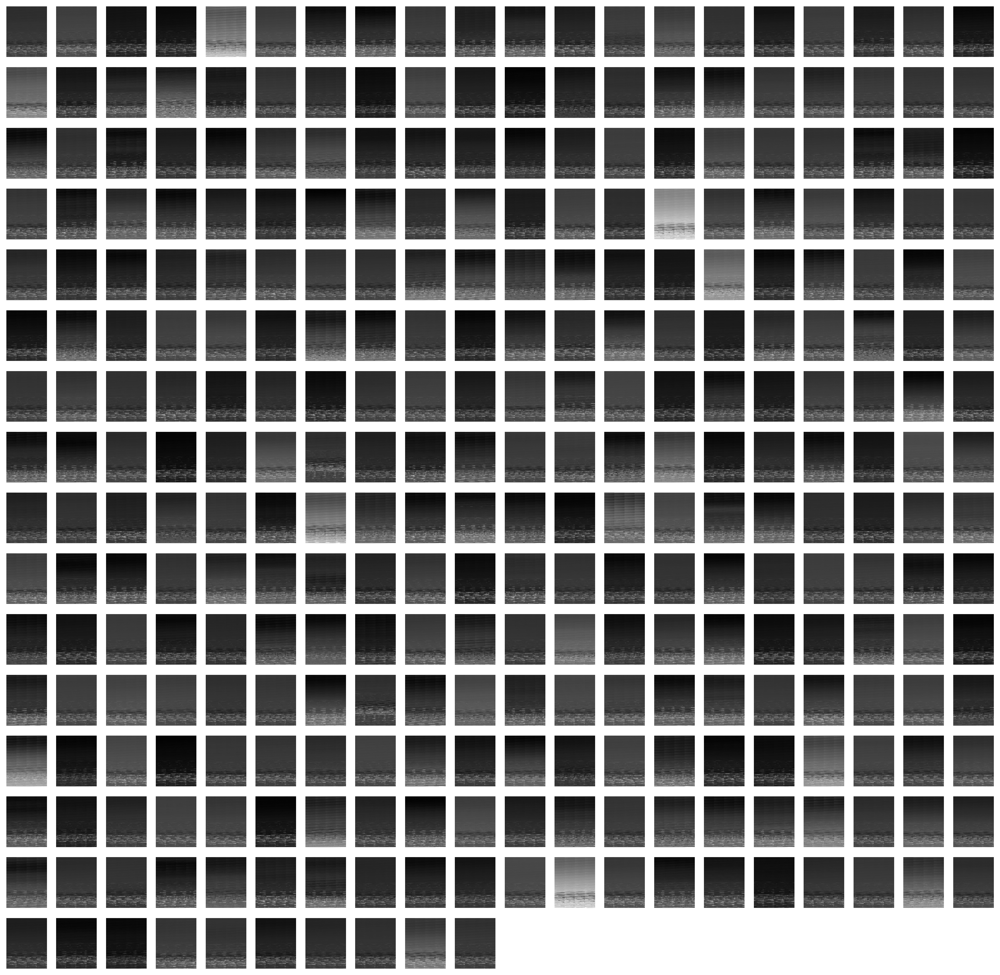

cluster 1
252 elements


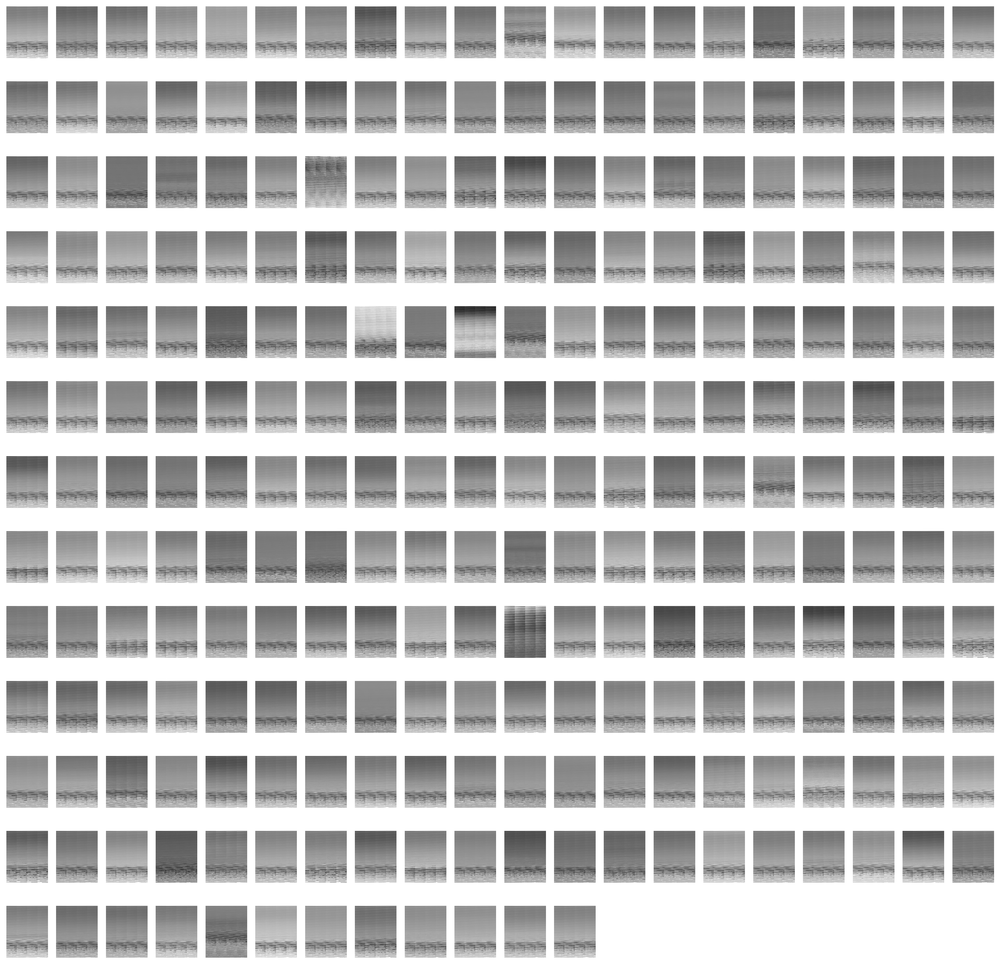

cluster 2
177 elements


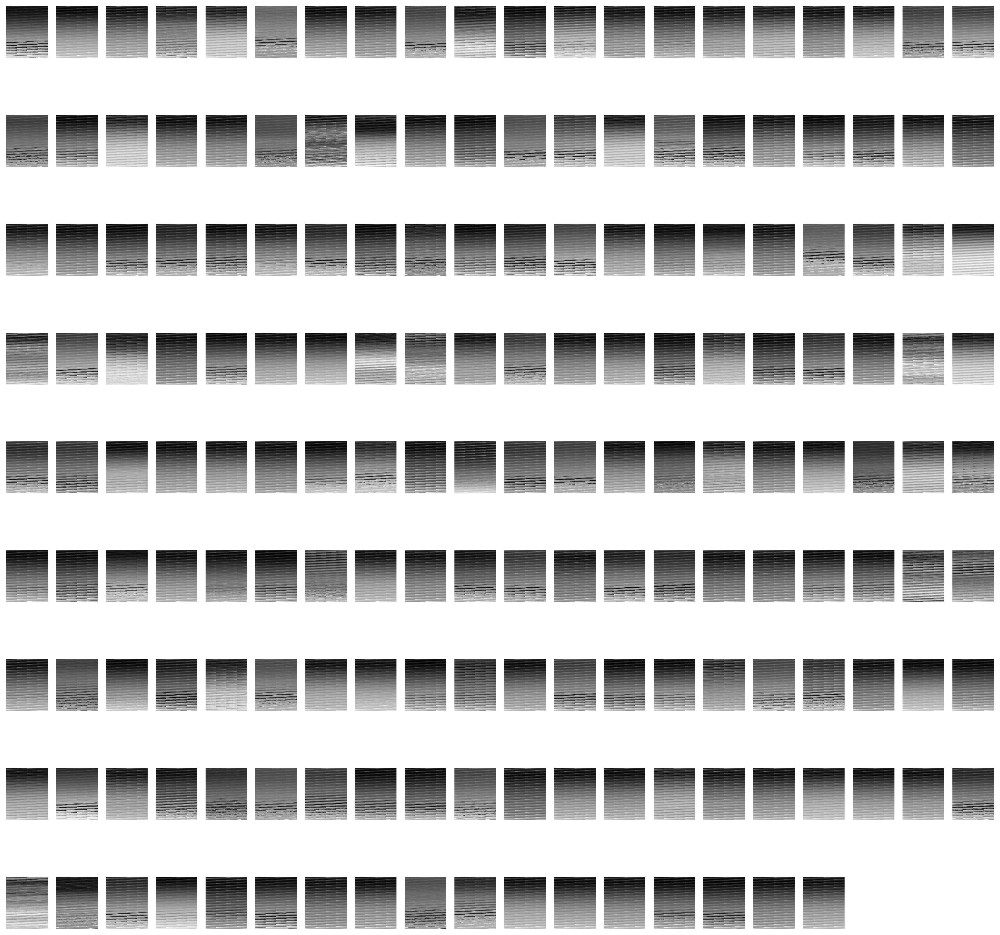

cluster 3
261 elements


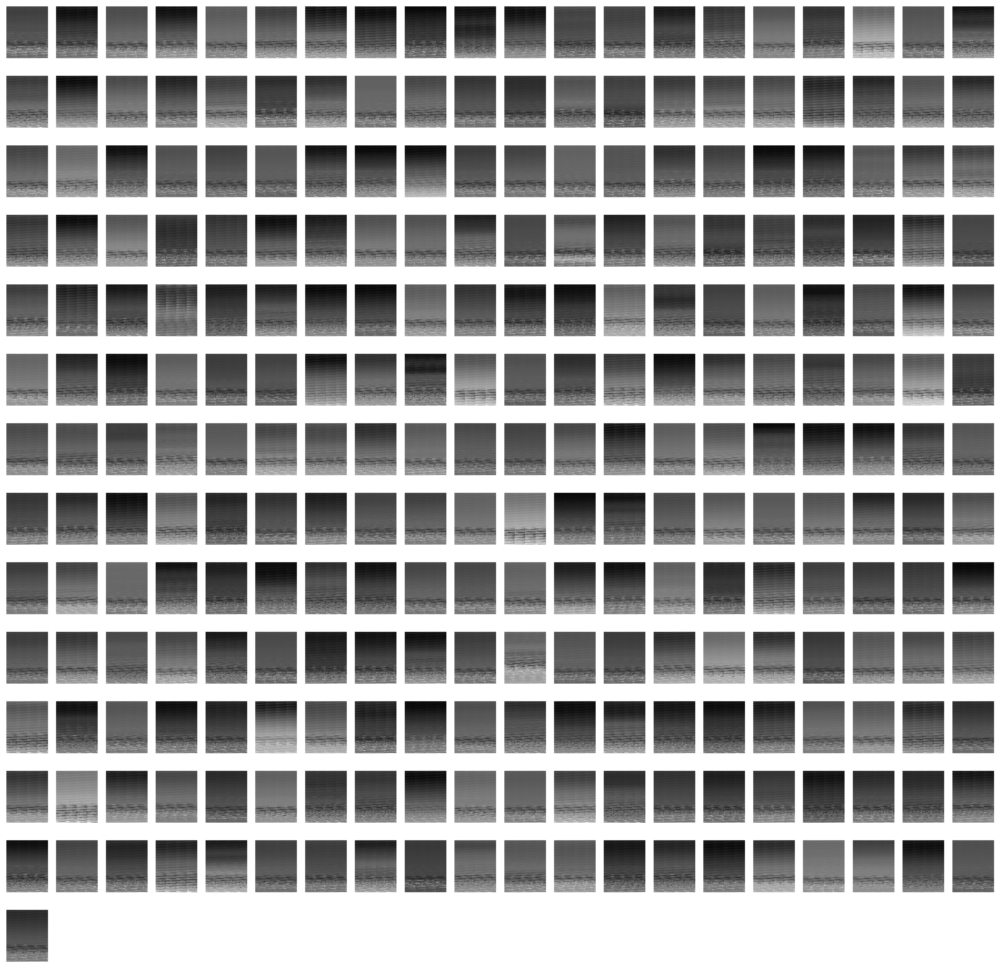

In [36]:
# We plot the resulting clusters
for i in range(0,n):
    
    row = np.where(Z==i)[0] # row in Z for elements of cluster i
    num = row.shape[0]      # number of elements for each cluster
    r = np.floor(num/20.)   # number of rows in the figure of the cluster
    
    print("cluster " + str(i))
    print(str(num) + " elements")
    
    plt.figure(figsize=(20,20), dpi=300)
    for k in range(0, num):
        plt.subplot(int(r+1), 20, k+1)
        image = img_reduced[row[k], ]
        image = image.reshape(160, 128)
        plt.imshow(image, cmap='gray')
        plt.axis('off')
    plt.show()

In [37]:
# holds the cluster id and the images { id: [images] }
groups = {}
for file, cluster in zip(filenames,kmeans.labels_):
    if cluster not in groups.keys():
        groups[cluster] = []
        groups[cluster].append(file)
    else:
        groups[cluster].append(file)

In [38]:
# print(f'Cluster 0: {groups[0]} \n')
# print(f'Cluster 1: {groups[1]} \n')
# print(f'Cluster 2: {groups[2]} \n')
# print(f'Cluster 3: {groups[3]} \n')

DBSCAN might not work well if your clusters have different densities

In [39]:
clustering = DBSCAN(eps=3000, min_samples=2).fit(img_reduced)
DBSCAN_labels = clustering.labels_
print(DBSCAN_labels)

[ 0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  1  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0 -1  0  0  0  0 -1  0  0  0  0  0  0  0  0  0  0  0  0
 -1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  0  0  0  0  0  0  0 -1  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0
  0  2  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0 -1  0  0  0  0  0
  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0

cluster 0
962 elements


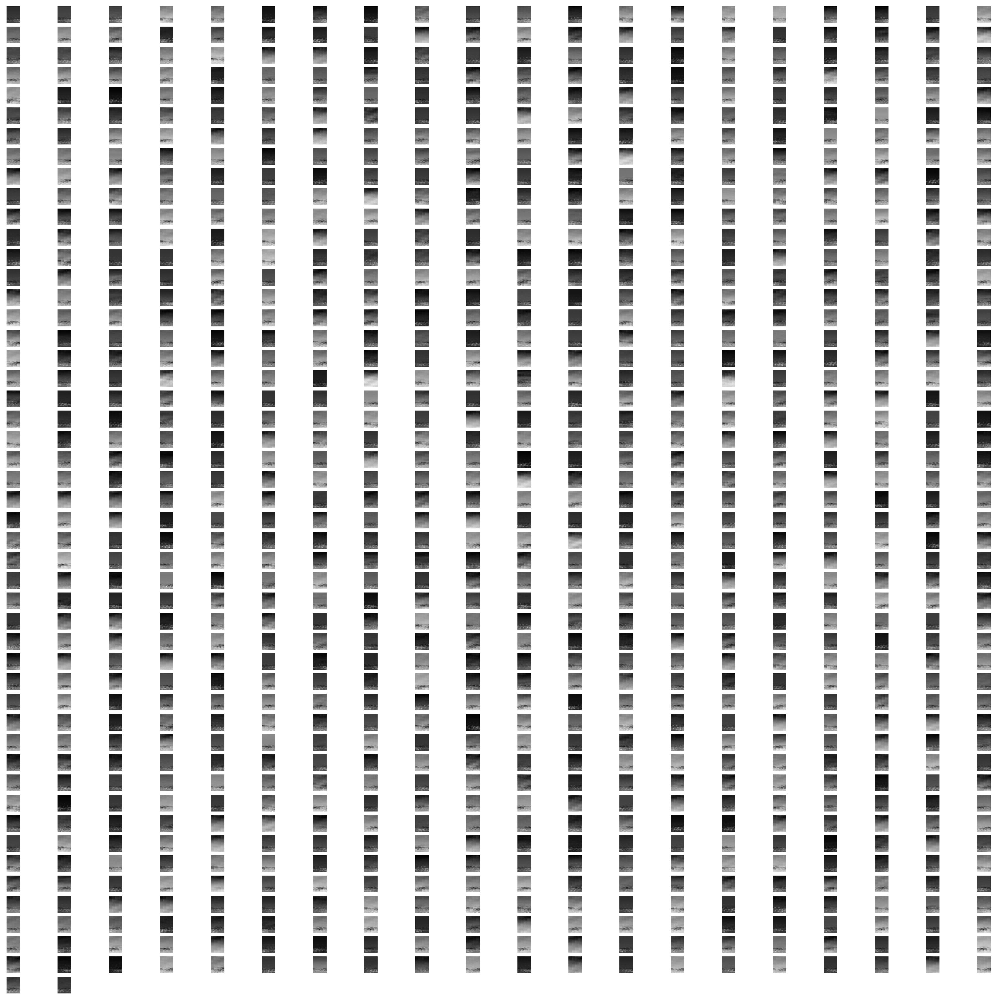

cluster 1
2 elements


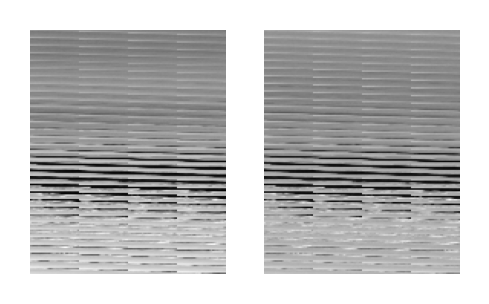

cluster 2
2 elements


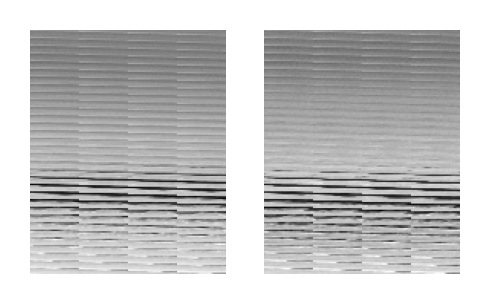

cluster 3
3 elements


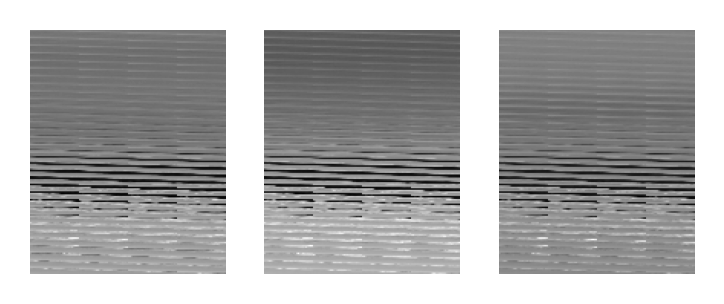

In [40]:
# We plot the resulting clusters
for i in range(0,n):
    
    row = np.where(DBSCAN_labels==i)[0] # row in Z for elements of cluster i
    num = row.shape[0]      # number of elements for each cluster
    r = np.floor(num/20.)   # number of rows in the figure of the cluster
    
    print("cluster " + str(i))
    print(str(num) + " elements")
    
    plt.figure(figsize=(20,20), dpi=300)
    for k in range(0, num):
        plt.subplot(int(r+1), 20, k+1)
        image = img_reduced[row[k], ]
        image = image.reshape(160, 128)
        plt.imshow(image, cmap='gray')
        plt.axis('off')
    plt.show()

### Gaussian Mixture Models

In [47]:
gmm = GaussianMixture(n_components=4)
gmm = gmm.fit(img_reduced)

MemoryError: Unable to allocate 12.5 GiB for an array with shape (4, 20480, 20480) and data type float64

In [49]:
# predictions from gmm
labels = gmm.predict(img_reduced)

AttributeError: 'GaussianMixture' object has no attribute 'means_'

In [ ]:
print(labels)

In [ ]:
# We plot the resulting clusters
for i in range(0,n):
    
    row = np.where(Z==i)[0] # row in Z for elements of cluster i
    num = row.shape[0]      # number of elements for each cluster
    r = np.floor(num/20.)   # number of rows in the figure of the cluster
    
    print("cluster " + str(i))
    print(str(num) + " elements")
    
    plt.figure(figsize=(20,20), dpi=300)
    for k in range(0, num):
        plt.subplot(int(r+1), 20, k+1)
        image = img_reduced[row[k], ]
        image = image.reshape(160, 128)
        plt.imshow(image, cmap='gray')
        plt.axis('off')
    plt.show()